In [1]:
import imp
import os
import logging

import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
import plotly
import statsmodels

from BuildingControlsSimulator.Simulator.Simulator import Simulator
from BuildingControlsSimulator.Simulator.Config import Config
from BuildingControlsSimulator.BuildingModels.IDFPreprocessor import IDFPreprocessor
from BuildingControlsSimulator.BuildingModels.EnergyPlusBuildingModel import EnergyPlusBuildingModel
from BuildingControlsSimulator.ControlModels.Deadband import Deadband

from BuildingControlsSimulator.DataClients.DataClient import DataClient
from BuildingControlsSimulator.DataClients.GCSFlatFilesSource import GCSFlatFilesSource
from BuildingControlsSimulator.OutputAnalysis.OutputAnalysis import OutputAnalysis


plotly.offline.init_notebook_mode(connected=True)
%load_ext autoreload
%autoreload 2


In [2]:

os.environ

environ{'PYENV_SHELL': 'bash',
        'LIB_DIR': '/home/bcs/lib',
        'ENERGYPLUSTOFMUSCRIPT': '/home/bcs/lib/external/EnergyPlusToFMU-3.0.0/Scripts/EnergyPlusToFMU.py',
        'HOSTNAME': '749dce064557',
        'DOCKER_EXT_DIR': '/home/bcs/lib/external',
        'EXT_DIR': '/home/bcs/lib/external',
        'DOCKER_IMAGE': 'building-controls-simulator',
        'OUTPUT_DIR': '/home/bcs/lib/building-controls-simulator/output',
        'DYD_METADATA_URI': 'gs://donate_your_data_2019/meta_data.csv',
        'LOCAL_CACHE_DIR': '/home/bcs/lib/building-controls-simulator/data/cache',
        'FMIL_HOME': '/home/bcs/lib/external/FMIL/build-fmil',
        'PWD': '/home/bcs/lib/building-controls-simulator',
        'PACKAGE_NAME': 'building-controls-simulator',
        'GOOGLE_APPLICATION_CREDENTIALS': '/home/bcs/.config/application_default_credentials.json',
        'WEATHER_DIR': '/home/bcs/lib/building-controls-simulator/weather',
        'DOCKER_PACKAGE_DIR': '/home/bcs/lib/building-

In [3]:
ff = DataClient(
    source=GCSFlatFilesSource(
        gcp_project=os.environ.get("FLATFILE_GOOGLE_CLOUD_PROJECT"),
        gcs_uri_base=os.environ.get("FLATFILES_GCS_URI_BASE"),
    ),
    nrel_dev_api_key=os.environ.get("NREL_DEV_API_KEY"),
    nrel_dev_email=os.environ.get("NREL_DEV_EMAIL"),
    archive_tmy3_dir=os.environ.get("ARCHIVE_TMY3_DIR"),
    archive_tmy3_meta=os.environ.get("ARCHIVE_TMY3_META"),
    archive_tmy3_data_dir=os.environ.get("ARCHIVE_TMY3_DATA_DIR"),
    ep_tmy3_cache_dir=os.environ.get("EP_TMY3_CACHE_DIR"),
    simulation_epw_dir=os.environ.get("SIMULATION_EPW_DIR"),
)

In [4]:
sim_config = Config.make_sim_config(
    identifier=[
        os.environ.get("TEST_FLATFILES_IDENTIFIER_FULL")  # has full data periods
    ],
    latitude=33.481136,
    longitude=-112.078232,
    start_utc="2018-06-01",
    end_utc="2018-09-01",
    min_sim_period="7D",
    min_chunk_period="30D",
    step_size_minutes=5,
)

In [5]:
%%time
master = Simulator(
    data_client=ff,
    sim_config=sim_config,
    building_models=[
        EnergyPlusBuildingModel(
            idf=IDFPreprocessor(idf_file="AZ_Phoenix_gasfurnace_crawlspace_IECC_2018_cycles.idf",),
        )
    ],
    controller_models=[Deadband(deadband=1.0),],
)


CPU times: user 2.9 s, sys: 102 ms, total: 3 s
Wall time: 3.03 s


In [6]:
%%time
# simulate
master.simulate(local=True, preprocess_check=True)

/home/bcs/.local/share/virtualenvs/building-controls-simulator-_QCXB2qn/lib/python3.7/site-packages/pandas/core/arrays/datetimelike.py:1345: PerformanceWarning:

Adding/subtracting object-dtype array to DatetimeArray not vectorized

/home/bcs/.local/share/virtualenvs/building-controls-simulator-_QCXB2qn/lib/python3.7/site-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray



CPU times: user 1min 20s, sys: 4.34 s, total: 1min 25s
Wall time: 2min 47s


In [11]:
from BuildingControlsSimulator.DataClients.DataStates import STATES

In [22]:
print(STATES.CALENDAR_EVENT.value)

4


In [35]:
STATES.HUMIDITY.value

9

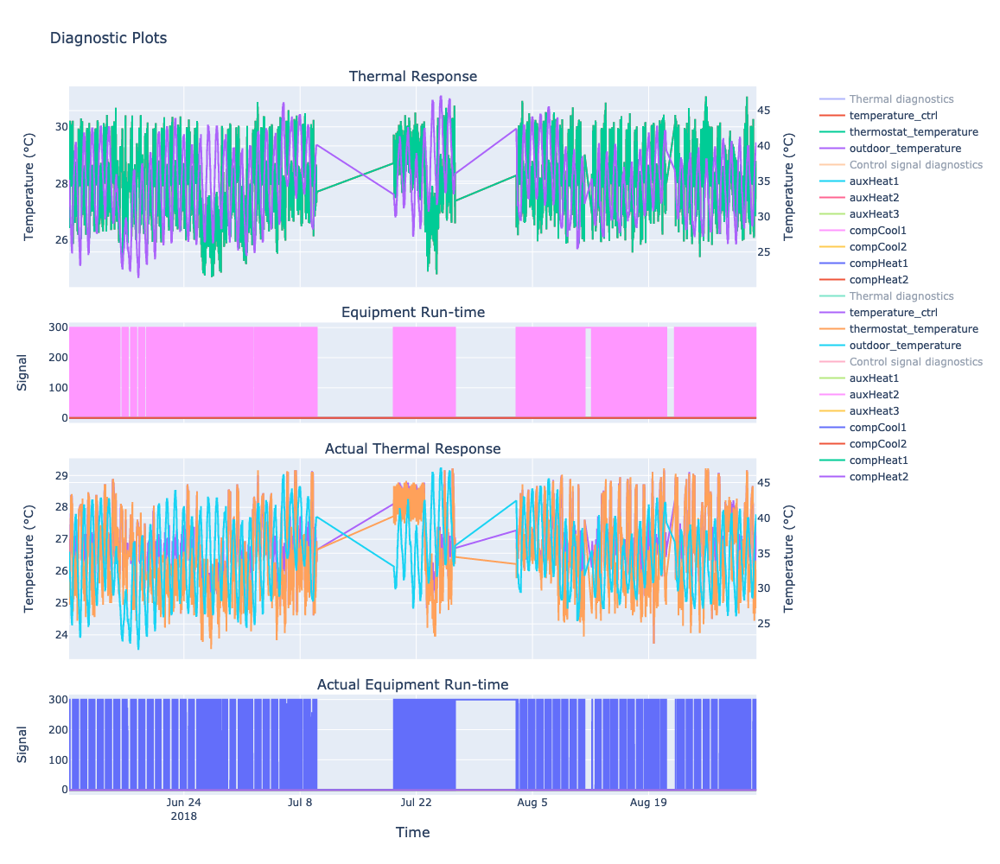

In [33]:
sim_analysis = OutputAnalysis(output_df=master.simulations[0].output, input_df=master.simulations[0].full_input)
sim_analysis.diagnostic_plot(show=True, actuals=True)

In [34]:
sim_analysis.postprocess()

AttributeError: 'OutputAnalysis' object has no attribute 'df'

In [25]:
master.simulations[0].output.columns

Int64Index([1, 51, 6, 12, 13, 14, 15, 16, 17, 18, 47, 48, 49, 50, 24, 25, 26], dtype='int64')

In [26]:
master.simulations[0].full_input.columns

Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 36, 28, 37, 45, 46],
           dtype='int64')

In [27]:
STATES.TEMPERATURE_STP_COOL.value

7